# Ceci est la partie 2 des TPs d'OASIS.
Le texte du TP est dans un fichier pdf et distribué par l'enseignant.

 techniquement: Lancer la première cellule sans y réfléchir.
 Les cellules d'après sont référencées en fonction des sections du TP et vous aident à réaliser ce qui est demandé par le sujet du TP.
  


In [8]:
import numpy as np
import simpleaudio as sa
from IPython.display import Audio,display
import sys
import tempfile
import IPython
from skimage.transform import rescale
import matplotlib.pyplot as plt
import subprocess
import scipy.io as io
import scipy
# simplification de certains noms.
pi=np.pi
sin=np.sin
exp=np.exp
cos=np.cos
log=np.log
fft=np.fft.fft
lfilter=scipy.signal.lfilter

Notebook=True #mettre False pour un python standard (pas notebook)



def joue_son(s,Fe=44100):
  """Joue un son et tient compte de la variable globale Notebook
   Le son est normalisé et joué à la fréquence d'échantillonnage Fe qui vaut
   44100 par défaut."""
  if len(s.shape)>1:
    print("joue_son erreur: Le son n'est pas mono!")
    return
  if not Notebook:
    son=s.copy().astype(np.float32)
    sm=(abs(son)).max()
    if sm==0:
      print("Attention: son uniformément nul!")
    else:
      son/=sm # normalisation
      son=son*(2**15-1)
    son=son.astype(np.uint16)
    play_obj = sa.play_buffer(son, 1, 2, Fe)
    play_obj.wait_done()
  else: # on est dans un notebook ou colab
    son=s.copy().astype(np.float32)
    sm=(abs(son)).max()
    if sm==0:
      print("Attention: son uniformément nul!")
    else:
      son/=sm # normalisation
    wm=Audio(son, rate=Fe, autoplay=False)
    display(wm)


def viewimage(im, normalize=True,zoom=1,order=0,titre='',displayfilename=False):
    imin=im.copy().astype(np.float32)
    if len(im.shape)>2:
      imin = rescale(imin, zoom, order=order, channel_axis=2)
    else:
      imin = rescale(imin, zoom, order=order)
    if normalize:
        imin-=imin.min()
        if imin.max()>0:
            imin/=imin.max()
    else:
        imin=imin.clip(0,255)/255
    imin=(imin*255).astype(np.uint8)
    filename=tempfile.mktemp(titre+'.png')
    if displayfilename:
        print (filename)
    plt.imsave(filename, imin, cmap='gray')
    IPython.display.display(IPython.display.Image(filename))

def charge_image(fich):
    a=np.float32(plt.imread(fich))
    return a


def lire_fichier_son(fichier):
  f=io.wavfile.read(fichier)
  if len(f[1].shape)>1:
    out=f[1][:,0] #pas de stereo
  else:
    out=f[1]
  Fe=f[0]
  return (out,Fe) # renvoie un canal sonore (pas de   stereo) et la Freq. d'echant. Fe

lien_donnees="https://www.telecom-paris.fr/perso/~ladjal/donnees_TP2_OASIS_2024.tgz"
fichier="donnees_2024.tgz"
repdonnees="donnees_2024/"
"""if not (lien_donnees is None):
  subprocess.run(["wget","-O",fichier,lien_donnees])
  subprocess.run(["tar","-xvzf",fichier])"""

subprocess.run(["tar","-xvzf",fichier])



CompletedProcess(args=['tar', '-xvzf', 'donnees_2024.tgz'], returncode=0)

In [9]:
s_chinois,Fe_chinois=lire_fichier_son(repdonnees+"chinois_as.wav")
joue_son(s_chinois,Fe_chinois)

In [10]:
s_voyelles,Fe_voyelles=lire_fichier_son(repdonnees+"aeiouou.wav")
joue_son(s_voyelles,Fe_voyelles)

# Q.1 
On enregistre sur CD le son d’une note ”la” `a 440Hz. On prend 1500 échantillons successifs de ce
CD et on en trace la TFD de taille 1500. Donner la position du ou des pics qui apparaissent ? ( Pour le CD on suppose Fe = 44000Hz)

On a f0 = 440 Hz, de fréquence réduite v = f0/Fe = 0.01
On a k = N*v = 15, la position du pic dans la TFD

# Le spectorgramme

Il vous est demandé de compléter la fonction une_colonne_spectrogramme.

 La fonction affiche_spectorgramme s'appuie sur la fonction une_colonne_spectrogramme

# Q.2 
On a que :
TFD de n à n + N de la suite (u.w') = Somme(u (m).w (m-n).exp(-2.i.pi.k/M.(m-n)))

avec w' la suite w translatée de n  

Ainsi, en multipliant chaque côté par exp(-2.i.pi.k/M.n), on obtient à droite le terme souhaité U(n,k/M)

On utilise ce résultat dans la fonction une_colonne_spectrogramme







In [15]:
fft=np.fft.fft
def une_colonne_spectrogramme(u,M,N,n):
    """
    Renvoie une colonne de spectrogramme c'est a dire la TFD de taille M
    d'une morceau de u debutant en n et de taille N multiplie par une fenetre
     de hamming """
    uu=u.copy().reshape(-1)  # on recopie sinon on risque d'ecraser
    # construction de la fnetre
    idx=np.arange(0,N)
    w=0.54-0.46*cos(2*pi*idx/(N-1))
    # les index tels que u(m)w(n-m) non nul
    m=np.arange(n,n+N).astype(int) #Taille du morceau débutant en n, on prend la partie allant de n à n+N
    morceauu=uu[m]  #morceau utile de u
    fenu=morceauu * w  #Produit
    Uc=fft(fenu,M) # on calcule la TFD
    Uc=abs(Uc) # on s'interesse seulement au module
    Uc=Uc[0:M//2+1] # pour un signal reel il suffit de garder la moitie
    return Uc


def affiche_spectrogramme(u,N,M=None,nb=None,Fe=8192,grain_freq=500,zoom=1):
    """Affiche le specrogramme du signal u
     La taille des fenetres est N
     Si M n'est pas fourni il est pris egal a N
     nb est le pas entre deux fenetres dont on calcule la TFD
     si nb n'est pas fourni, nb est pris egal a N/2"""

    if M is None:
        M=N
    if nb is None:
        nb=N/2
    # On commence par creer un tableau de la bonne taille don les colonnes seront
    # calculees par une_colonne_spectrogramme
    uu=u.copy().reshape(-1)
    L=len(u)
    nombre_fen=int((L-N)//nb+1)
    spectro=np.zeros((M//2+1,nombre_fen))
    for k in range(nombre_fen):
        spectro[:,k]=une_colonne_spectrogramme(u,M,N,k*nb)
    temps_debut=0
    temps_fin=1/Fe*nb*nombre_fen
    freq_debut=0
    freq_fin=Fe/2   #On prend pour fréquence de fin freq_fin = Fe/2 pour pouvoir appliquer le critère de Shannon avec une fréquence d'échantillonage de Fe, on évite le repliement

    # ci-dessous de la cuisine python pour un affichage d'une image deux fois
    # plus large que haute (tailleaff est la pour pallier le defaut d'interactivite de colab)
    if Notebook:
      tailleaff=(60*zoom,60*zoom)
    else:
      tailleaff=(6*zoom,6*zoom)
    fig, ax = plt.subplots(figsize=tailleaff)
    ax.imshow(np.log(np.flipud(spectro)), interpolation='none', # cmap=plt.cm.Reds
              extent=[temps_debut,temps_fin,freq_debut,freq_fin])
    ax.set_aspect(1/2*(temps_fin/freq_fin))
    ax.set_yticks(np.arange(freq_debut,freq_fin,grain_freq))
    return spectro



# Affichage d'un spectrogramme
Après avoir vcomplété le code ci-dessus vous pouvez analyser des sons en utilisant la focntion affiche_spectrogramme

Attention les valeurs par défaut ne permettent pas une bonne visulaisation du spectrogramme.

Si vous voulez que l'échelle des frequences soient visible à un endroit essayez
affiche_spectrogramme(u[Fe:]...
comme cela vous l'analyse commence au temps 1s. (google colab ne permet pas une interactivité avec les graphiques).


array([[1.13286280e+06, 1.15771315e+06, 1.12538089e+06, ...,
        1.11697335e+06, 1.11445059e+06, 1.11054113e+06],
       [4.74848743e+05, 4.69137594e+05, 5.04507577e+05, ...,
        4.73639016e+05, 4.65380358e+05, 4.73331781e+05],
       [4.89647495e+03, 2.77757256e+04, 2.19823777e+04, ...,
        1.84516848e+04, 1.61907823e+04, 1.51534415e+04],
       ...,
       [6.90697083e+02, 1.15932193e+03, 4.68006988e+02, ...,
        1.35582536e+01, 1.04656159e+01, 1.86045316e+01],
       [7.03227628e+02, 1.16354591e+03, 4.41234648e+02, ...,
        1.13313450e+01, 1.52012657e+01, 1.72178673e+01],
       [7.11299936e+02, 1.14942352e+03, 4.58312389e+02, ...,
        6.26495594e-01, 5.54314427e+00, 9.65471227e+00]])

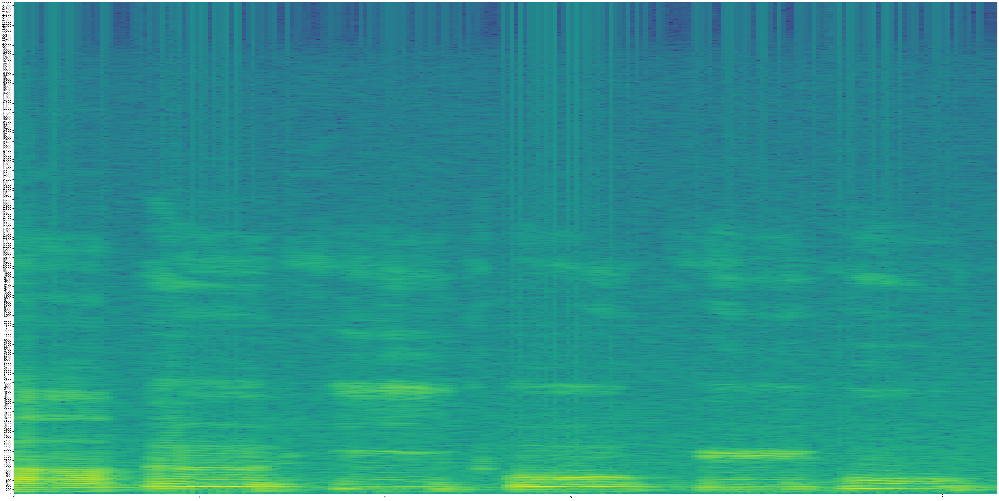

In [18]:
affiche_spectrogramme(s_voyelles,8192,M=8192,nb=1024,Fe=Fe_voyelles,grain_freq=100,zoom=1)

# Q.2
 Observer le spectrogramme du signal sonore s_voyelles [a e i o u ou]. Pouvez-vous compter le nombre de voyelles prononcées en regardant le spectrogramme ?

Il est possible de compter le nombre de voyelles prononcées en regardant les différentes parties du spectrogramme. On remarque en effet 6 colonnes correspondant aux 6 sons prononcées dans le fichier audio, avec pour chaque colonne les fréquences respectives.

array([[5.62197215e+05, 5.61755207e+05, 5.61812964e+05, ...,
        5.58085273e+05, 5.57713342e+05, 5.57632793e+05],
       [2.38801210e+05, 2.38665960e+05, 2.38115599e+05, ...,
        2.37511843e+05, 2.37071990e+05, 2.36421322e+05],
       [9.04373266e+02, 7.40811637e+02, 4.06080047e+02, ...,
        1.71552244e+03, 1.86190414e+03, 2.02258904e+03],
       ...,
       [1.27846688e+01, 1.27164185e+01, 1.68834567e+01, ...,
        1.47053350e+01, 1.23872670e+01, 1.38601182e+01],
       [1.00617504e+01, 1.02979577e+01, 1.14374746e+01, ...,
        1.52712228e+01, 7.55278973e+00, 1.53759906e+01],
       [5.77228348e-01, 4.26166424e+00, 8.82011636e+00, ...,
        6.38540782e+00, 1.79857666e+01, 9.64358514e+00]])

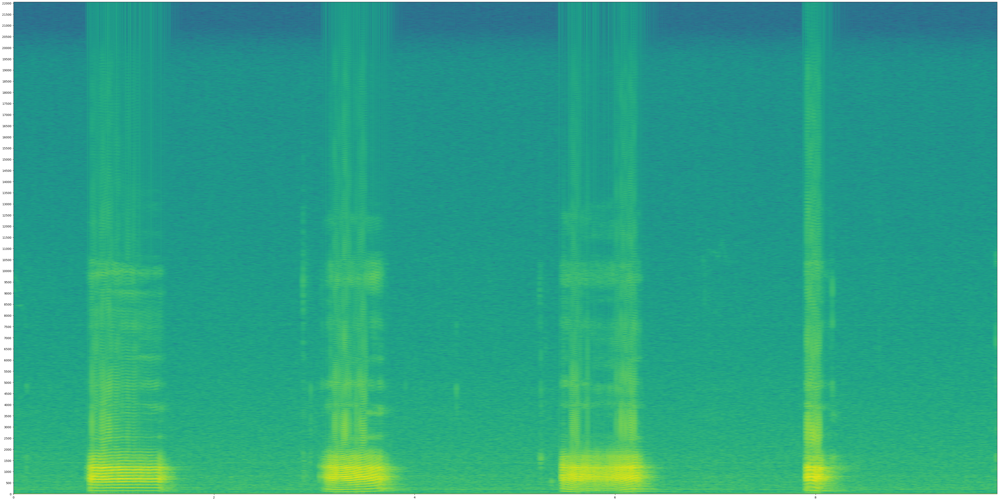

In [ ]:
affiche_spectrogramme(s_chinois,4096,4096,128,Fe=Fe_chinois,grain_freq=500,zoom=1)

De même pour ce son, on remarque les 4 sons "aahhh" prononcés distinctement.

# Q.3

Les raies que l'on observe sur le spectrogramme d'une voyelle proviennent du SLI cavité bucale

# Q.4

Le son "u" a une fréquence principale plus grande que le son "ou" (avec respectivement environ 1500-1600 Hz pour "u" et 500-600 Hz pour "ou")
Le reste des colonnes du spectrogramme est similaire pour ces deux sons à part pour cette différence.

# Q.5

La fréquence fondamentale approximative des cordes vocales du locuteur est de 100Hz environ (elle est la première fréquence présente sur tous les sons).

# Q.6
Pour chinois_is.wav, on remarque que les fréquences qui composent ce spectrogramme sont plus nommbreuses que pour chinois_us.wav
On en déduit que le son chinois_is.wav est plus riche au niveau fréquentiel pour les sons.

En observant l'évolution des fréquences présentes lors de la prononciation du son "a" (avec les 4 différentes pronociations différentes pour le mandarin),
on remarque que les fréquences changent pour la pronociation du même son au cours du temps selon l'intonation choisie.
Par exemple, pour le 2e "a", en regardant le spectrogramme au cours du temps, on voit que des fréquences autour de 4500 Hz présentes au début de la prononciation ne sont plus présentes à la fin du son, contrairement au 3e "a" qui contient ces fréquences tout au long de la prononciation. On y voit les différentes intonations, tout en conservant les mêmes fréquences principales, ce qui témoigne des différentes prononciations d'un même son.

Cela s'explique davantage par une variation des cordes vocales.

array([[5.65002031e+05, 5.64849716e+05, 5.64548988e+05, ...,
        5.55215501e+05, 5.54615418e+05, 5.55230721e+05],
       [2.40772169e+05, 2.40199547e+05, 2.39830969e+05, ...,
        2.38798144e+05, 2.39028423e+05, 2.37779225e+05],
       [2.67432919e+03, 2.68074277e+03, 2.59999130e+03, ...,
        3.23404727e+03, 3.17833842e+03, 4.28453657e+03],
       ...,
       [1.17474908e+01, 1.38799566e+01, 1.47813924e+01, ...,
        4.61381458e+00, 8.97032917e+00, 1.14813013e+01],
       [1.53222874e+01, 1.24937977e+01, 1.10114019e+01, ...,
        1.58329525e+01, 1.43774312e+01, 1.43919666e+01],
       [2.35783862e+00, 4.13603279e+00, 6.31919734e+00, ...,
        1.85432464e+00, 2.42221951e+00, 1.72179431e+00]])

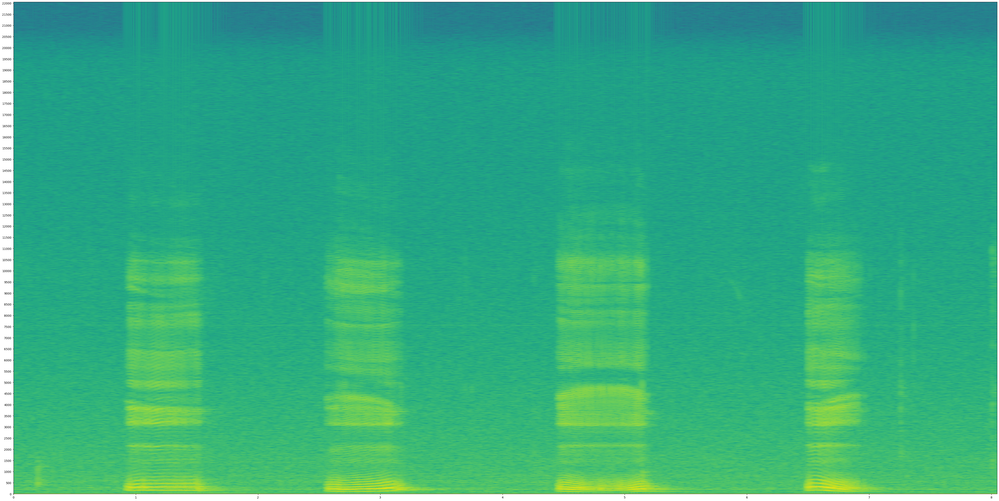

In [19]:
s_chinois_is,Fe_chinois_is=lire_fichier_son(repdonnees+"chinois_is.wav")
joue_son(s_chinois_is,Fe_chinois_is)
affiche_spectrogramme(s_chinois_is,4096,4096,128,Fe=Fe_chinois_is,grain_freq=500,zoom=1)

array([[5.64111825e+05, 5.64163748e+05, 5.64790042e+05, ...,
        5.65186473e+05, 5.66724038e+05, 5.66700254e+05],
       [2.40629607e+05, 2.40934361e+05, 2.40675056e+05, ...,
        2.43515133e+05, 2.43794474e+05, 2.45238987e+05],
       [6.30054746e+02, 6.28917699e+02, 5.30683722e+02, ...,
        3.79435022e+03, 4.53827895e+03, 4.25832198e+03],
       ...,
       [1.57386227e+01, 2.06145167e+01, 1.18854418e+01, ...,
        2.99294414e+01, 2.99260266e+01, 3.18378372e+01],
       [1.77032172e+01, 1.85627819e+01, 2.20504214e+01, ...,
        1.47557632e+01, 1.31856501e+01, 8.07088207e+00],
       [1.02852104e+01, 9.56179262e+00, 7.22632595e+00, ...,
        4.58113642e+00, 5.95264957e+00, 1.10900855e+01]])

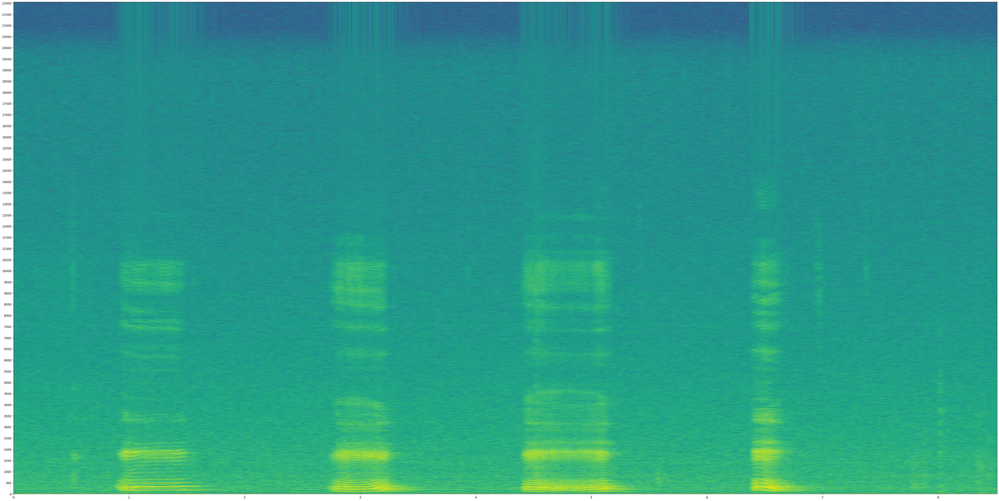

In [20]:
s_chinois_us,Fe_chinois_us=lire_fichier_son(repdonnees+"chinois_us.wav")
joue_son(s_chinois_us,Fe_chinois_us)
affiche_spectrogramme(s_chinois_us,4096,4096,128,Fe=Fe_chinois_us,grain_freq=500,zoom=1)

# Q.7
Fe/2 la fréquence de fin, t/T la dérivée souhaitée, avec f'(t) = Fe/2 * t/T, intègre pour obtenir f (on prend une constante nulle)
f_de_t = (Fe/2) * (t**2/2) / T

array([[1.23610487e+02, 8.64636614e+00, 2.07758115e+00, ...,
        7.70421349e-03, 4.85195087e-03, 1.16006203e-02],
       [2.60211680e+02, 8.39142416e+01, 4.71609443e+00, ...,
        7.70425126e-03, 4.85197334e-03, 1.16006749e-02],
       [7.85547739e+01, 2.57710523e+02, 3.00575181e+01, ...,
        7.70436178e-03, 4.85204319e-03, 1.16008383e-02],
       ...,
       [4.19320408e-02, 4.12578501e-02, 5.51750759e-02, ...,
        3.60870086e+00, 1.21177989e+02, 2.27714958e+02],
       [4.19314488e-02, 4.12572675e-02, 5.51742968e-02, ...,
        3.30704757e+00, 1.46936892e+01, 2.20717754e+02],
       [4.19312515e-02, 4.12570734e-02, 5.51740371e-02, ...,
        3.88690030e+00, 2.98716038e+00, 3.44957265e+01]])

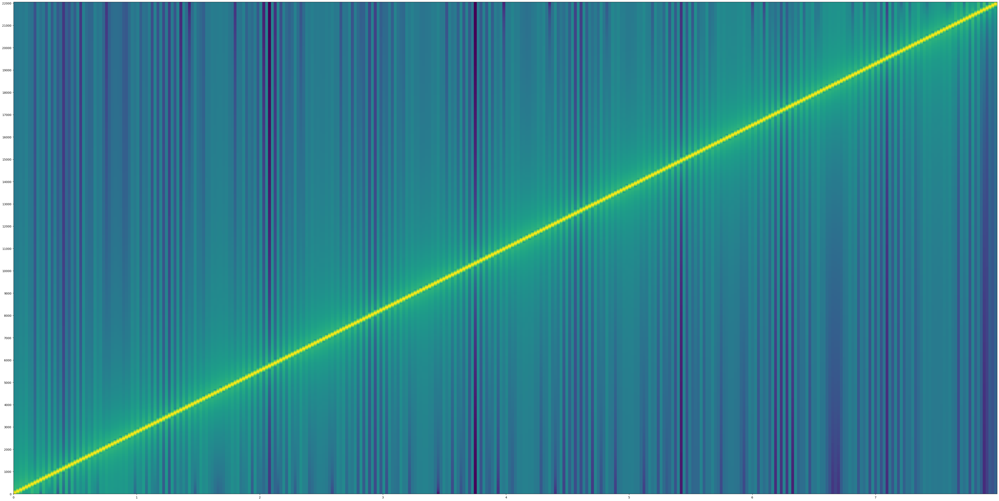

In [26]:
# Proposition pour son dont la fréquence augemente progressivement

Fe=44100
T=8 #secondes
t=np.arange(0,T*Fe)/Fe #le temps en seconde de l'echantillonage
f_de_t = (Fe/2) * (t**2/2) / T # Fonction souhaitée
s=np.cos(2*pi*f_de_t)
joue_son(s,Fe)
affiche_spectrogramme(s,1024,1024,1024,Fe=Fe,grain_freq=1000,zoom=1)


# Q.7

On observe un spectrogramme linéaire en fréquence, comme celui attendu avec une telle fonction

Avec le son sous échantilloné, on observe un rempliement en fréquence

# Q.8

On a une symétrisation du signal à la moitié de la durée du signal
La fréquence croit jusqu'à T/2 puis décroit de la fréquence finale jusqu'à 0 à partir de T/2

Il faut doubler l'axe des ordonnées pour retrouver la fréquence maximale du signal. En effet, en écoutant le son ci-dessous, la fréquence Fe/2 est atteinte à T/2 (on ne l'entend plus sur l'ordinateur)

# Q.9

On a TFtD [ s[::2] ] (nu) = (1/2) * (TFtD[ u ](nu/2) + TFtD[ u ](nu/2 - 1/2))

Les deux termes expliquent le repliement sur la deuxième moitié du spectrogramme, le critère de Shannon n'est plus respecté

In [28]:
# On joue le meme son en le sous-echantillonnat.

joue_son(s[::2],Fe/2)
affiche_spectrogramme(s[::2],1024,1024,1024,Fe=Fe//2)


array([[1.35745242e+01, 3.51483627e-01, 5.18395824e-03, ...,
        1.57027968e+00, 2.48323802e+00, 6.45065976e+00],
       [7.13911904e+01, 3.91834393e-01, 6.18299184e-02, ...,
        1.57615283e+00, 2.49898076e+00, 1.64456426e+01],
       [1.61308409e+02, 5.21967104e-01, 1.25254969e-01, ...,
        1.59399593e+00, 2.54256366e+00, 4.76132921e+01],
       ...,
       [7.37684359e-04, 9.60494062e-03, 3.20028876e-02, ...,
        7.85351273e-03, 6.85695685e-03, 6.19428403e-03],
       [7.37673913e-04, 9.60480472e-03, 3.20024339e-02, ...,
        7.85337437e-03, 6.85684751e-03, 6.19419350e-03],
       [7.37670430e-04, 9.60475942e-03, 3.20022826e-02, ...,
        7.85332661e-03, 6.85680781e-03, 6.19416289e-03]])

In [ ]:
joue_son(s[::2], Fe) 

# Q.10 Le signal dure deux fois moins longtemps, et le repliement spectral ne disparaît pas pour autant
Augmenter la fréquence d'échantillonage par rapport au signal sous-échantilloné n'empêche le repliement

In [30]:
# Proposition de filtrage
lfilter=scipy.signal.lfilter
def z_de_rho_theta(rho,theta):
  return rho*cos(theta/180*pi)+1j*rho*sin(theta/180*pi)
poles=[z_de_rho_theta(0.95,90),z_de_rho_theta(0.95,-90)] # COMPLETER (angles et modules)

zeros=[]
for k in range (1,4):
  zeros.append(z_de_rho_theta(1,90+20*k))
  zeros.append(z_de_rho_theta(1,270-20*k))

def poly_de_zeros(liste_zeros):
  """ renvoie un polynome en z^(-1) dont les zéros sont ceux de la liste
  """
  poly=np.zeros(1+len(liste_zeros))
  poly[0]=1
  for z0 in liste_zeros:
    poly=lfilter([1,-z0],1,poly)
  return poly

A=poly_de_zeros(poles)
B=poly_de_zeros(zeros)
# A vous d'utiliser lfilter et de corriger la liste des poles et des zeros pour avoir un bon filtrage avant sous echantillonnage
sfilt=lfilter(B, A, s)
joue_son(sfilt[::2],Fe=Fe//2)
affiche_spectrogramme(sfilt[::2],128,128,64,Fe=Fe//2)

C:\Users\Arnaud\AppData\Local\Temp\ipykernel_21108\77106190.py:44: ComplexWarning: Casting complex values to real discards the imaginary part
  son=s.copy().astype(np.float32)


array([[1.18005556e+03, 1.12836077e+03, 9.26030151e+02, ...,
        6.26228949e+00, 8.33874866e+00, 8.98893170e+00],
       [5.12568802e+02, 4.94062560e+02, 4.20825069e+02, ...,
        2.92329527e+00, 3.67629674e+00, 3.89576959e+00],
       [1.75882378e+00, 6.01354639e+00, 1.08149141e+01, ...,
        9.73493042e-02, 5.48828718e-02, 3.11826478e-02],
       ...,
       [1.07851711e+00, 1.38284852e-01, 3.83945201e-01, ...,
        3.67808050e-03, 1.50307039e-03, 3.72869558e-04],
       [1.06048497e+00, 1.39254417e-01, 3.83602286e-01, ...,
        3.67478496e-03, 1.50172543e-03, 3.72531798e-04],
       [9.00737572e-01, 1.40411072e-01, 3.83489283e-01, ...,
        3.67367950e-03, 1.50127145e-03, 3.72420646e-04]])

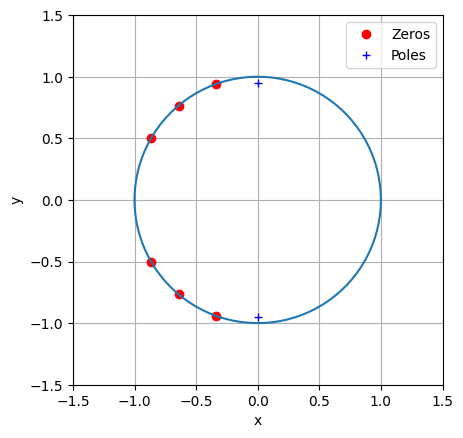

In [33]:
# Q.11

plt.plot(np.real(zeros),np.imag(zeros),'or',label='Zeros') #Cercle rouge
plt.plot(np.real(poles),np.imag(poles),'+b', label='Poles') #Croix bleu
plt.plot(np.cos(np.linspace(0, 2*np.pi, 100)), np.sin(np.linspace(0, 2*np.pi, 100))); plt.gca().set_aspect('equal'); plt.grid(True); plt.xlim(-1.5, 1.5); plt.ylim(-1.5, 1.5); plt.xlabel('x'); plt.ylabel('y');

plt.legend()
plt.show()